# Derive Initial Velocity from Total Energy

In [1]:
%matplotlib widget
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML

In [2]:
from smbbh_nu import SMBBH_NU
from plot_process import Plot_Result

## 0. 參數設置

In [3]:
m1, m2 = 0.5, 0.5
black_hole_mass = [m1, m2]  # m1, m2
radius = 2  #2
eccentricity = 0.0
# constant_c = 0.0
t0, tf = 0, 50
angles = [np.pi/6, np.pi/4, np.pi/6]  # omega, I, Omega

In [4]:
def potential_1(constant_c, comp_vector, r):
    c_term = (constant_c*comp_vector) / r
    first_term = 1/(r + r**3)
    second_term = np.arctan(r)/(r**2)
    V = c_term*(first_term - second_term)
    return V

## 1. 假設總能量

$E_{total} = E_{1} + E_{2}$  
$E_{i} =  \frac{1}{2}(u_{i}^{2} + v_{i}^{2} + w_{i}^{2}) - \frac{m_{j}^{3}}{r_{i}(m_{1} + m_{2})^{2}} - c\frac{\arctan{(r_{i})}}{r_{i}}, i\neq j, i, j \in \{ 1, 2 \}$  
$c = \frac{2}{\pi}M_{g}$

In [5]:
egy_total = 0
egy_1 = egy_total*0.5
egy_2 = egy_total*0.5
c = (2/np.pi)*m1*1000  # 假設星系總質量為單一黑洞的 1000 倍
print(r'$M_{g} = $', c*(np.pi/2))

$M_{g} = $ 500.0


In [6]:
p1_v0 = np.sqrt(2*(egy_1 + (m2**2)/((radius*0.5)*(m1 + m2)**2) + c*(np.arctan(radius*0.5)/(radius*0.5))))
p2_v0 = np.sqrt(2*(egy_2 + (m1**2)/((radius*0.5)*(m1 + m2)**2) + c*(np.arctan(radius*0.5)/(radius*0.5))))

In [7]:
print(r'p1 $v_{0}$ : ', p1_v0)
print(r'p2 $v_{0}$ : ', p2_v0)

p1 $v_{0}$ :  22.371857321197094
p2 $v_{0}$ :  22.371857321197094


In [8]:
experiment_1 = SMBBH_NU(black_hole_mass,
                        t0=t0,
                        tf=tf,
                        constant_c=c,
                        radius=radius,
                        eccentricity=eccentricity,
                        angles=angles,
                        potential_function=potential_1)



experiment_1.v1_0 = np.array([0.0, p1_v0, 0.0])
experiment_1.v2_0 = np.array([0.0, -p2_v0, 0.0])

# experiment_1.e = 1 - (p1_v0**2)/(experiment_1.init_c_vel**2)

print(experiment_1.v1_0)
exp_dict = experiment_1.run()

[ 0.         22.37185732  0.        ]


## 2. Plot

In [9]:
# rot_command = str(input("Would you like to rotate the binary black hole orbit trajectory in 3D? [y]/n : "))
rot_command = "n"
rot_mod = "rotation" if rot_command == "y" else "no_rotation"
plot = Plot_Result(exp_dict, radius, t0, tf)

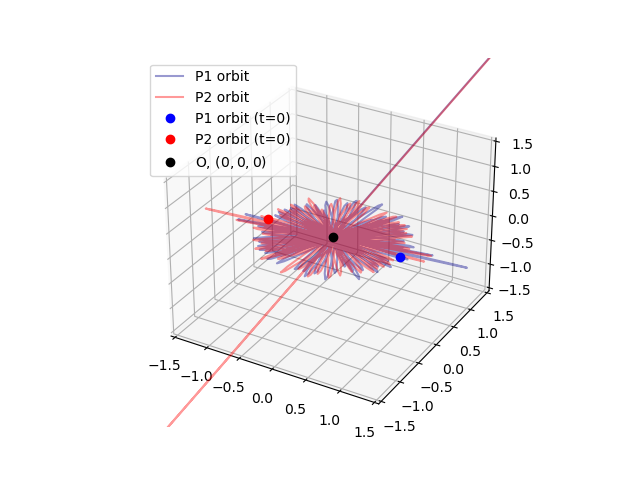

In [10]:
plot.plot_rk4_result(mode=rot_mod)

In [11]:
ani = plot.plot_orbit_video(mode=rot_mod, show_mode='html')
plt.close()
HTML(ani.to_jshtml(fps=10))

Animation size has reached 21162327 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
